<a href="https://colab.research.google.com/github/netmatze/mlmatze/blob/main/stable_diffusion_using_huggingface_pipeline_for_different_models.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install --quiet --upgrade diffusers transformers accelerate mediapy triton scipy ftfy spacy==3.4.4
!pip install -q xformers==0.0.16rc425
!pip install mediapy

In [ ]:
from diffusers import PNDMScheduler, DDIMScheduler, LMSDiscreteScheduler, EulerDiscreteScheduler, DPMSolverMultistepScheduler
import mediapy as media
import torch
from diffusers import StableDiffusionPipeline
import random
from PIL import Image
import matplotlib.pyplot as plt

combined_list_images = []
combined_list_generated_models = []
combined_list_prompts = []
combined_list_generated_tags = []

def null_safety(images, **kwargs):
    return images, False

def flatten(listItems):
    return [item for sublist in listItems for item in sublist]

model_ids = [
              "stabilityai/stable-diffusion-2-1",
              "runwayml/stable-diffusion-v1-5",
              "dreamlike-art/dreamlike-photoreal-2.0",
              "dreamlike-art/dreamlike-anime-1.0",
              "dreamlike-art/dreamlike-diffusion-1.0",
              "hakurei/waifu-diffusion",
              "andite/anything-v4.0",
              "ckpt/anything-v4.5",
              "Joeythemonster/anything-midjourney-v-4-1",
              #"prompthero/openjourney",
              # "andite/cutesexyrobutts-diffusion",
              "hassanblend/HassanBlend1.5.1.2",
              "OfficialUnstableDiffusion/UnstablePhotoRealv.5",
              #"ImNoOne/f222-inpainting-diffusers",
              #"SY573M404/f222-diffusers"
            ]
model_index = [False, False, True, True, True, True, True, True]
device = "cuda"

num_images = 4
seed = random.randint(0, 2147483647)

ideas = [
      #"time series, stocks, stock exchange, realistic, time, high detail, realistic, intricate detail",
      #"create a time series, time series, stock, stock exchange, realistic, time, high detail, realistic, intricate detail",
      #"create a time series, time series, stock, stock exchange, cinematic lighting, metal design, realistic, intricate detail",
      #"query, index, vector, document, language, chain, langchain, high detail, realistic, intricate detail",
      #"timeseries, prediction, stocks, stock, high detail, intricate detail",
      #"regularization, explaination, ridge, lasso, regression, high detail, intricate detail, cinematic lighting, metal design",
      #"language model, llm, large language model, model, transformer, neuronal network, network, high detail, intricate detail, cinematic lighting, metal design"
      "nude, girl, woman, black, looking like a cat, cat, tiny tits, high detail, realistic, intricate detail"
      #"nude, girl, red hair, looking like a cat, cat, tiny tits, high detail, realistic, intricate detail"
      # "padlock, key, binary code, encryption, cryptography, high detail",
      # "whiteboard, explain, c++ code, intricate detail",
      #"scanner, digitize documents, encryption, high security"
      #"sugar cube, cup of tea, sugar, diffusing, high detail, realistic, intricate detail",
      #"person, walking, misty forest, trees, plants, high detail, realistic, intricate detail",
      #"drop of oil on water, oil diffusing, colorful pattern, high detail, realistic, intricate detail",
      # "woman, knitting, wool, outside, colorfull pattern, high detail, realistic, intricate detail",
      # "strumming a guitar, sound, air, diffusing, colorful pattern, high detail, realistic, intricate detail",
      # "bubbles in a park, bubbles diffusing, floating away, colorful pattern, high detail, realistic, intricate detail",
#      "laptop, VPN with a lock symbol, high detail, realistic, intricate detail,",
#      "firewall, block unauthorized access, network, high detail, realistic, intricate detail",
#     "young asian woman, highly detailed, green eyes, bathing in wool, knitting a pullover, realistic",
#     "Anthropomorphic blue owl, highly detailed, big green eyes, portrait, detailed armor, unreal engine, cinematic lighting, metal design, 8k, octane render, realistic, redshift render",
#     "enraged warrior, monsterlike armor, living armor, full body portrait, organic armor, high detail, intricate detail, mdjrny-v4 style",
#     "young black woman, nude, big breasts, green eyes, high detail, intricate detail",
#      "polar bear, flying in space, moon in the background, sun on the right side with bright red glow, everything neon light like",
#      "polar bear, padlock and key, binary code background, network, high detail, realistic, intricate detail, mdjrny-v4 style",
#      "cat, virtual private network, VPN, smartphone, high detail, realistic, intricate detail",
#      "keyboard, python coding language in the background, high detail, realistic, intricate detail",
#      "blue owl, highly detailed, big green eyes, portrait, detailed armor, cinematic lighting, metal design, 8k, octane render, realistic, redshift render"
]

# ideas = [
#     # "young asian woman, nude, big breasts, green eyes, realistic, high detail, intricate detail, full body portrait",
#     # "nude blond girl, sitting at a couch, nude, open pussy, big breasts, high detail, realistic, intricate detail, full body portrait",
#     "nude red head girl, standing near a tree, nude, finger in open pussy, small breasts, high detail, realistic, intricate detail, full body portrait"
#     "nude man, fucking, nude girl, open pussy, big tits, high detail, realistic, intricate detail, "
# ]

tags = [
     ["padlock", "key", "binary code", "data encryption", "cryptography"],
     ["whiteboard", "explanation", "communication", "idea", "brainstorming"],
     ["scanner", "digitization", "paperwork", "document management", "technology"],
     ["scanner", "digitization", "paperwork", "document management", "technology"],
     ["scanner", "digitization", "paperwork", "document management", "technology"],
     ["scanner", "digitization", "paperwork", "document management", "technology"],
    # ["sugar cube", "cup of tea", "sugar", "diffusing"],
    # ["person", "walking", "misty forest", "trees", "plants"],
    # ["drop of oil on water", "oil diffusing", "colorful pattern"],
    # ["woman", "knitting", "wool", "colorful pattern"],
    # ["guitar", "air", "diffusing", "air"],
    # ["bubbles", "diffusing", "floating", "colorful pattern"],
    # ["chemistry", "science", "laboratory", "diffusion gradient", "flask"],
    # ["perfume", "cologne", "fragrance", "diffusion", "room"],
    # ["breath", "water vapor", "diffusion", "cold weather", "condensation"],
    # ["smoke", "incense", "candle", "diffusion", "atmosphere"],
    # ["cooking", "soup", "aroma", "diffusion", "kitchen"],
    # ["soap bubbles", "diffusion", "pattern", "beauty", "fun"],
    # ["cityscape", "smog", "fog", "diffusion", "atmosphere"],
    # ["air freshener", "scent", "diffusion", "room", "fresh"],
    # ["flower", "scent", "aroma", "diffusion", "nature"],
    # ["dandelion", "seeds", "diffusion", "nature", "beauty"],
    # ["coffee", "milk", "mixing", "beverage", "breakfast"],
    # ["garden", "hose", "watering", "lawn", "irrigation"],
    # ["music", "speaker", "sound waves", "vibration", "entertainment"],
    # ["fan", "cooling", "air currents", "summer", "heat"],
    # ["dominoes", "falling", "sequence", "game", "entertainment"],
    # ["cooking", "soup", "stirring", "ingredients", "comfort food"],
    # ["wind chime", "breeze", "sound waves", "relaxation", "decoration"],
    # ["waterfall", "cascade", "rocks", "pool", "nature"],

    # ["dye", "water", "color", "diffusion", "chemistry"],
    # ["eyes", "iris", "dilation", "light", "vision"],
    # ["solar panel", "sunlight", "energy", "diffusion", "renewable"],
    # ["wax", "mold", "filling", "diffusion", "craft"],
    # ["face", "mist", "essential oils", "diffusion", "aromatherapy"],
    # ["smoke bomb", "smoke", "colorful", "diffusion", "outdoors"],
    # ["city street", "crowded", "traffic", "diffusion", "urban"],
    # ["glitter", "sparkle", "airborne", "diffusion", "celebration"],
    # ["stress ball", "pressure", "relief", "diffusion", "handheld"],
    # ["ice cream cone", "melting", "dripping", "diffusion", "dessert"],
    # ["sugar cube", "tea", "sweetening", "diffusion", "beverage"],
    # ["ear", "sound waves", "hearing", "diffusion", "anatomy"],
    # ["forest", "misty", "atmosphere", "diffusion", "nature"],
    # ["oil", "water", "pattern", "diffusion", "art"],
    # ["guitar", "strumming", "music", "diffusion", "entertainment"],
    # ["bubbles", "floating", "playful", "diffusion", "childhood"],
    # ["tomato", "juices", "cutting board", "diffusion", "cooking"],
    # ["feet", "sandy beach", "walking", "diffusion", "vacation"]
    # ["network scanning", "vulnerability assessment", "penetration testing", "ethical hacking", "cybersecurity"],
    # ["firewall", "network security", "data protection", "information security", "internet security"],
    # ["animal", "bear", "polar bear", "snow", "moon", "neon"],
    # ["animal", "bear", "polar bear", "padlock", "key", "neon"],
    # ["animal", "cat", "virtual private network", "VPN", "smartphone"],
    # ["keyboard", "python", "coding", "language"],
    # ["animal", "owl", "portrait", "green eyes"],
    ]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


  0%|          | 0/350 [00:00<?, ?it/s]

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/350 [00:00<?, ?it/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/350 [00:00<?, ?it/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/350 [00:00<?, ?it/s]

prompt: timeseries, prediction, stocks, stock, high detail, intricate detail


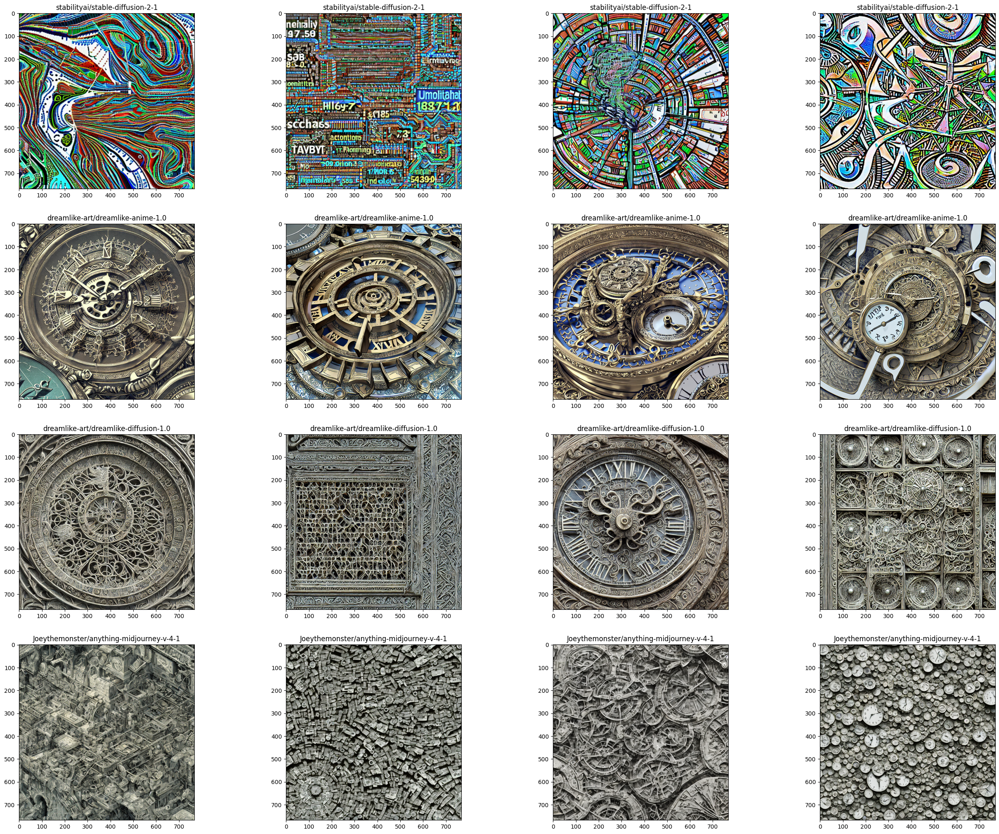

,,,,,,,,,,,,,,,

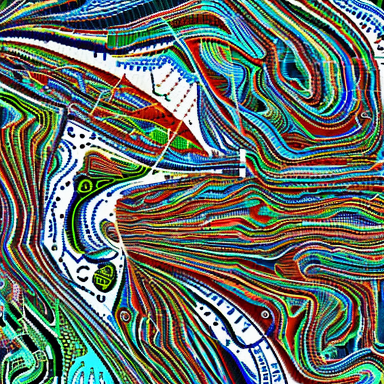
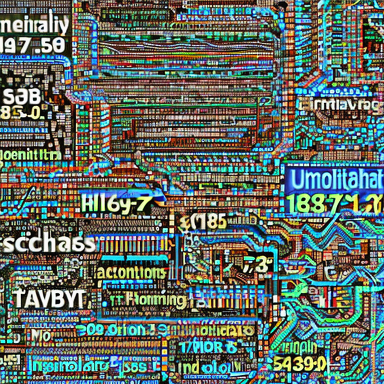
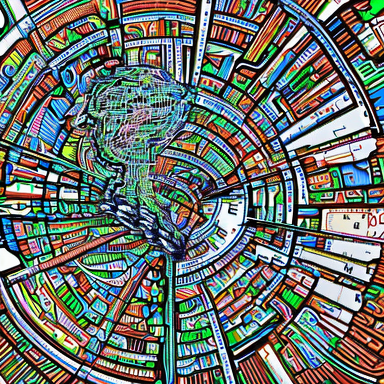
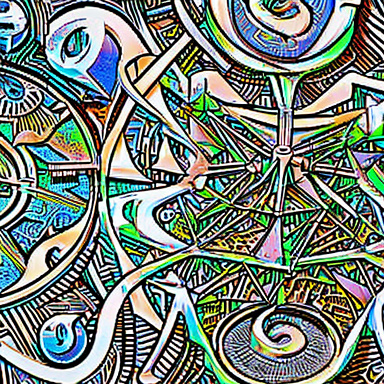
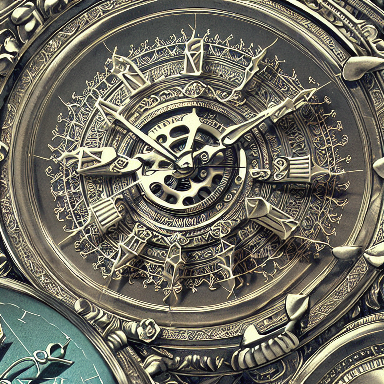
...
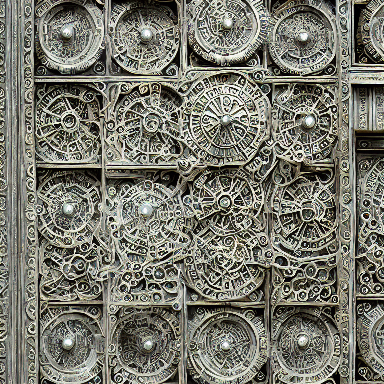
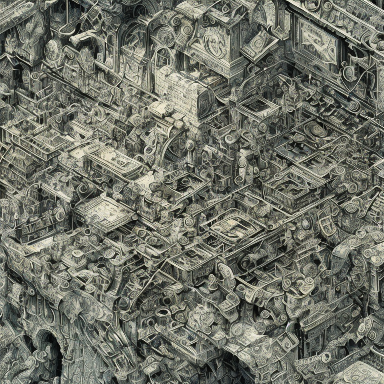
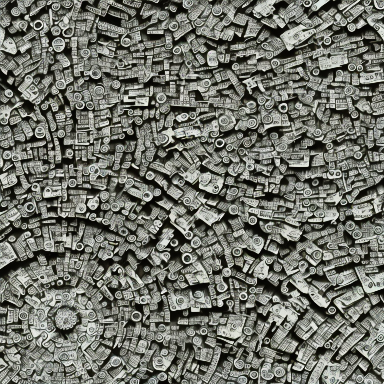
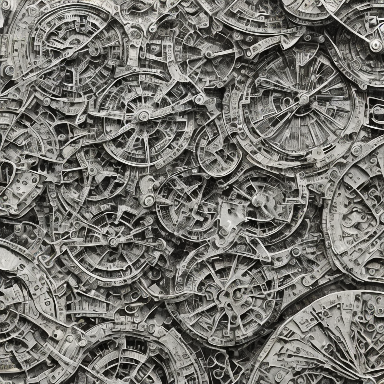
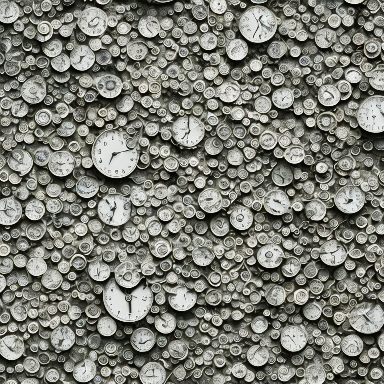

In [ ]:
# from diffusers import PNDMScheduler, DDIMScheduler, LMSDiscreteScheduler, EulerDiscreteScheduler, DPMSolverMultistepScheduler
# import mediapy as media
# import torch
# from diffusers import StableDiffusionPipeline
# import random
# from PIL import Image
# import matplotlib.pyplot as plt

# combined_list_images = []
# combined_list_generated_models = []
# combined_list_prompts = []

# def null_safety(images, **kwargs):
#     return images, False

# def flatten(listItems):
#     return [item for sublist in listItems for item in sublist]

# model_ids = [
#               "stabilityai/stable-diffusion-2-1",
#               # "runwayml/stable-diffusion-v1-5",
#               # "dreamlike-art/dreamlike-photoreal-2.0",
#               # "dreamlike-art/dreamlike-anime-1.0",
#               # "hakurei/waifu-diffusion",
#               # "andite/anything-v4.0",
#               "ckpt/anything-v4.5",
#               "Joeythemonster/anything-midjourney-v-4-1",
#               # "prompthero/openjourney",]
#               # "andite/cutesexyrobutts-diffusion",
#               #"hassanblend/HassanBlend1.5.1.2"]
#             ]
# model_index = [False, False, True, True, True, True, True, True]
# device = "cuda"

# num_images = 2
# seed = random.randint(0, 2147483647)

# #prompt = "girl, aqua eyes, yellow baseball cap, with a cute cat"
# #prompt = "best quality, girl, blonde hair, pink eyes with a cute little dog"
# #prompt = "masterpiece, best quality, sunnflowers and orange roses at the moon"
# #prompt = "james rizzi style easter bunny rides with bike to the moon to hide easter eggs"
# #prompt = "best quality, a pattern of different meadow flowers and daisy"
# #prompt = "best quality, a cat with a hat riding a horse"

# ideas = [
#     # "A chemical reaction taking place in a flask with a diffusion gradient visible in the background.",
#     # "A person spraying perfume or cologne in a room, with the scent diffusing through the air.",
#     # "A close-up of a person's breath condensing in the cold air, with the diffusion of the water vapor visible.",
#     # "Smoke diffusing in the air from an incense stick or a burning candle.",
#     # "A person stirring a pot of soup, with the aroma diffusing through the kitchen.",
#     # "A person blowing soap bubbles, with the bubbles diffusing in the air and creating a beautiful pattern.",
#     # "A shot of a city skyline with smog or fog diffusing in the air.",
#     # "A person spraying a can of air freshener in a room, with the fresh scent diffusing through the air.",
#     # "A close-up of a flower releasing its scent into the air, with the diffusion of the aroma visible.",
#     # "A person blowing on a dandelion, with the seeds diffusing in the air.",
#     # "A person pouring milk into a cup of coffee, with the milk visibly mixing into the coffee.",
#     # "A shot of a garden hose spraying water onto a lawn, with the water spreading out evenly across the grass.",
#     # "A close-up of a speaker vibrating as it plays music, with the sound waves spreading out through the air.",
#     # "A person using a hand-held fan to cool off on a hot day, with the air currents visible.",
#     # "A shot of a row of dominoes, with one falling and causing the others to fall in sequence.",
#     # "A person stirring a pot of soup, with the ingredients mixing together to create a flavorful broth.",
#     # "A close-up of a wind chime moving in the breeze, with the sound waves spreading out through the air.",
#     # "A shot of a waterfall cascading down a series of rocks, with the water spreading out into a pool at the bottom.",

#     # "A person squeezing a dropper of dye into water, with the dye slowly diffusing and coloring the water.",
#     # "A close-up of a person's eyes, with the iris dilating as light diffuses through the pupil.",
#     # "A shot of a solar panel array with the sun diffusing light across the surface.",
#     "A person pouring hot wax into a mold, with the wax diffusing and filling the mold.",
#     "A close-up of a person's face with mist from a diffuser diffusing essential oils.",
#     "A person holding a smoke bomb, with the smoke diffusing in the air and creating a colorful cloud.",
#     # "A shot of a crowded city street, with people and traffic diffusing in every direction.",
#     # "A person tossing a handful of glitter into the air, with the glitter diffusing and creating a sparkling effect.",
#     # "A close-up of a person's fingers playing with a stress ball, with the pressure diffusing throughout the ball.",
#     # "A shot of a person's hand holding a dripping ice cream cone, with the melting ice cream diffusing down the cone.",
#     # "A person dropping a sugar cube into a cup of tea, with the sugar slowly diffusing and sweetening the tea.",
#     # "A close-up of a person's ear, with sound waves diffusing through the ear canal.",
#     # "A shot of a person walking through a misty forest, with the mist diffusing around the trees and plants.",
#     # "A person placing a drop of oil on water, with the oil diffusing and creating a colorful pattern.",
#     # "A close-up of a person's fingers strumming a guitar, with the sound diffusing through the air.",
#     # "A shot of a person blowing bubbles in a park, with the bubbles diffusing and floating away.",
#     # "A person cutting into a ripe tomato, with the juices diffusing and dripping onto a cutting board.",
#     # "A close-up of a person's feet walking on a sandy beach, with the sand diffusing beneath their toes."
# ]

# tags = [
#     ["chemistry", "science", "laboratory", "diffusion gradient", "flask"],
#     ["perfume", "cologne", "fragrance", "diffusion", "room"],
#     ["breath", "water vapor", "diffusion", "cold weather", "condensation"],
#     ["smoke", "incense", "candle", "diffusion", "atmosphere"],
#     ["cooking", "soup", "aroma", "diffusion", "kitchen"],
#     ["soap bubbles", "diffusion", "pattern", "beauty", "fun"],
#     ["cityscape", "smog", "fog", "diffusion", "atmosphere"],
#     ["air freshener", "scent", "diffusion", "room", "fresh"],
#     ["flower", "scent", "aroma", "diffusion", "nature"],
#     ["dandelion", "seeds", "diffusion", "nature", "beauty"],
#     ["coffee", "milk", "mixing", "beverage", "breakfast"],
#     ["garden", "hose", "watering", "lawn", "irrigation"],
#     ["music", "speaker", "sound waves", "vibration", "entertainment"],
#     ["fan", "cooling", "air currents", "summer", "heat"],
#     ["dominoes", "falling", "sequence", "game", "entertainment"],
#     ["cooking", "soup", "stirring", "ingredients", "comfort food"],
#     ["wind chime", "breeze", "sound waves", "relaxation", "decoration"],
#     ["waterfall", "cascade", "rocks", "pool", "nature"],

#     ["dye", "water", "color", "diffusion", "chemistry"],
#     ["eyes", "iris", "dilation", "light", "vision"],
#     ["solar panel", "sunlight", "energy", "diffusion", "renewable"],
#     ["wax", "mold", "filling", "diffusion", "craft"],
#     ["face", "mist", "essential oils", "diffusion", "aromatherapy"],
#     ["smoke bomb", "smoke", "colorful", "diffusion", "outdoors"],
#     ["city street", "crowded", "traffic", "diffusion", "urban"],
#     ["glitter", "sparkle", "airborne", "diffusion", "celebration"],
#     ["stress ball", "pressure", "relief", "diffusion", "handheld"],
#     ["ice cream cone", "melting", "dripping", "diffusion", "dessert"],
#     ["sugar cube", "tea", "sweetening", "diffusion", "beverage"],
#     ["ear", "sound waves", "hearing", "diffusion", "anatomy"],
#     ["forest", "misty", "atmosphere", "diffusion", "nature"],
#     ["oil", "water", "pattern", "diffusion", "art"],
#     ["guitar", "strumming", "music", "diffusion", "entertainment"],
#     ["bubbles", "floating", "playful", "diffusion", "childhood"],
#     ["tomato", "juices", "cutting board", "diffusion", "cooking"],
#     ["feet", "sandy beach", "walking", "diffusion", "vacation"]
#     ]

is_adult_prompt = True
negative_prompt = None
model_revision = None
tags_counter = 0
for promptvalue in ideas:
  prompt = promptvalue
  list_images = []
  list_generated_models = []

  for index, model_id in enumerate(model_ids):
    pipe = StableDiffusionPipeline.from_pretrained(
        model_id,
        torch_dtype=torch.float16,
        revision=model_revision
        )
    pipe = pipe.to(device)
    pipe.enable_xformers_memory_efficient_attention()

    if model_index == True:
      pipe.safety_checker = null_safety

    image_length = 768 #512 #768

    images = pipe(
        prompt,
        height = image_length,
        width = image_length,
        num_inference_steps = 350,
        guidance_scale = 9,
        num_images_per_prompt = num_images,
        negative_prompt = negative_prompt,
        generator = torch.Generator("cuda").manual_seed(seed)
        ).images
    for image_item in images:
      # print(model_id)
      list_images.append(image_item)
      combined_list_images.append(image_item)
      list_generated_models.append(model_id)
      combined_list_generated_models.append(model_id)
      combined_list_prompts.append(prompt)
      combined_list_generated_tags.append(tags[tags_counter])
  tags_counter += 1
  # flatten_image_list = list_images # flatten(list_images)
  # media.show_images(flatten_image_list)

  fig = plt.figure(figsize=(32, 32))
  columns = 4
  rows = int(len(list_images) / columns) + 1
  print(f'prompt: {prompt}')
  for i in range(1, len(list_images) + 1):
      if len(list_images) < i:
        print(f'list_images error {len(list_images)} < {str(i)}')
      fig.add_subplot(rows, columns, i)
      plt.title(list_generated_models[i - 1])
      plt.imshow(list_images[i - 1])
  plt.show()

media.show_images(combined_list_images)

,,,,,,,,,,,,,,,

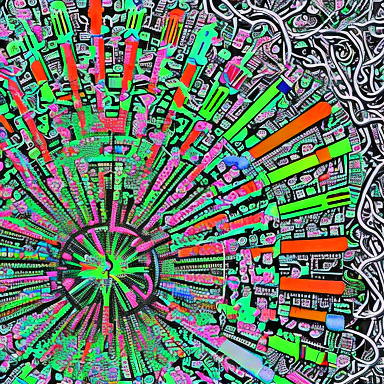
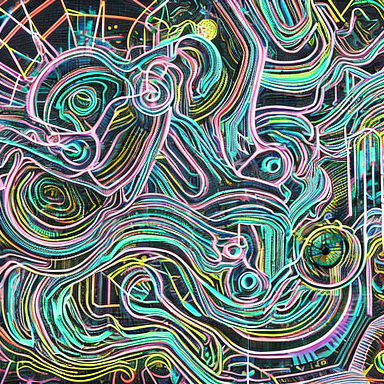
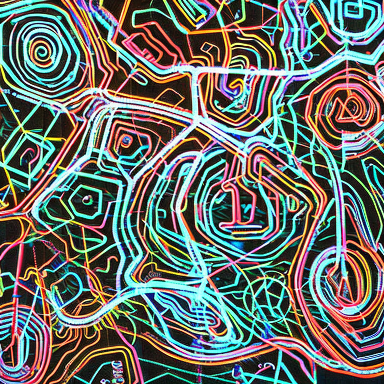
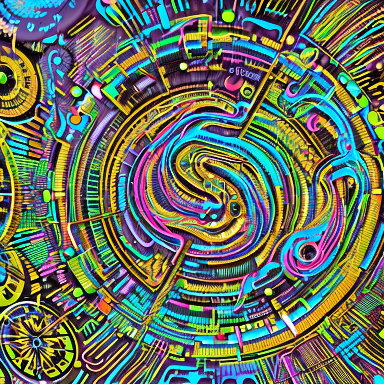
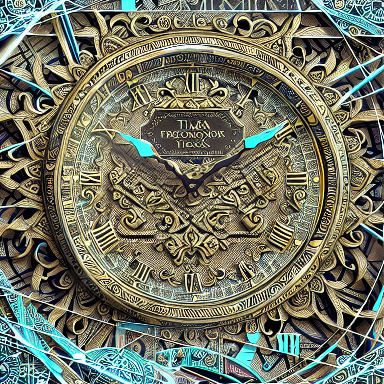
...
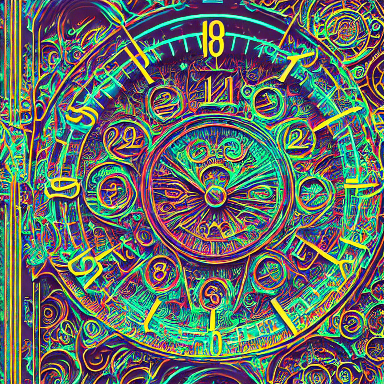
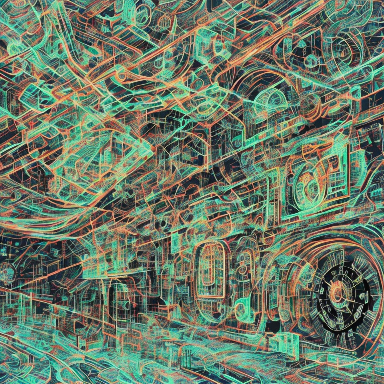
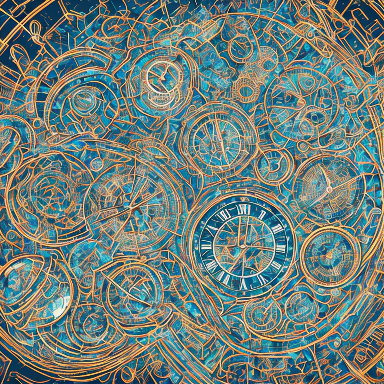
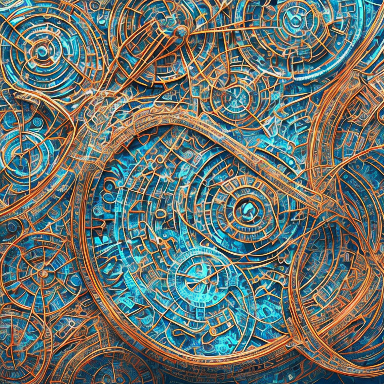
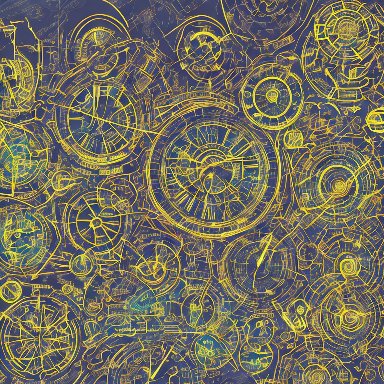

In [ ]:
media.show_images(combined_list_images)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
#list_of_selected_images = [5,6,7,11]
list_of_selected_images = [3,4,5,13,1]

2_timeseries, time, prediction, stocks, high detail, neon design, intricate detail - stabilityai/stable-diffusion-2-1


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

3_timeseries, time, prediction, stocks, high detail, neon design, intricate detail - stabilityai/stable-diffusion-2-1


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

4_timeseries, time, prediction, stocks, high detail, neon design, intricate detail - stabilityai/stable-diffusion-2-1


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

5_timeseries, time, prediction, stocks, high detail, neon design, intricate detail - dreamlike-art/dreamlike-anime-1.0


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

6_timeseries, time, prediction, stocks, high detail, neon design, intricate detail - dreamlike-art/dreamlike-anime-1.0


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

7_timeseries, time, prediction, stocks, high detail, neon design, intricate detail - dreamlike-art/dreamlike-anime-1.0


╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <cell line: 6>:16                                                                             │
│                                                                                                  │
│ /usr/local/lib/python3.9/dist-packages/matplotlib/figure.py:757 in add_subplot                   │
│                                                                                                  │
│    754 │   │   │   │   args = tuple(map(int, str(args[0])))                                      │
│    755 │   │   │   projection_class, pkw = self._process_projection_requirements(                │
│    756 │   │   │   │   *args, **kwargs)                                                          │
│ ❱  757 │   │   │   ax = projection_class(self, *args, **pkw)                                     │
│    758 │   │   │   key = (projection_class, pkw)                                                 │
│    759 │   │   return self._add_axes_internal(ax, key)                                           │
│    760                                                                                           │
│                                                                                                  │
│ /usr/local/lib/python3.9/dist-packages/matplotlib/axes/_base.py:644 in __init__                  │
│                                                                                                  │
│    641 │   │   │   self._position = mtransforms.Bbox.from_bounds(*args[0])                       │
│    642 │   │   else:                                                                             │
│    643 │   │   │   self._position = self._originalPosition = mtransforms.Bbox.unit()             │
│ ❱  644 │   │   │   subplotspec = SubplotSpec._from_subplot_args(fig, args)                       │
│    645 │   │   if self._position.width < 0 or self._position.height < 0:                         │
│    646 │   │   │   raise ValueError('Width and height specified must be non-negative')           │
│    647 │   │   self._originalPosition = self._position.frozen()                                  │
│                                                                                                  │
│ /usr/local/lib/python3.9/dist-packages/matplotlib/gridspec.py:598 in _from_subplot_args          │
│                                                                                                  │
│   595 │   │   │   i, j = num                                                                     │
│   596 │   │   else:                                                                              │
│   597 │   │   │   if not isinstance(num, Integral) or num < 1 or num > rows*cols:                │
│ ❱ 598 │   │   │   │   raise ValueError(                                                          │
│   599 │   │   │   │   │   f"num must be an integer with 1 <= num <= {rows*cols}, "               │
│   600 │   │   │   │   │   f"not {num!r}"                                                         │
│   601 │   │   │   │   )                                                                          │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
ValueError: num must be an integer with 1 <= num <= 20, not 32

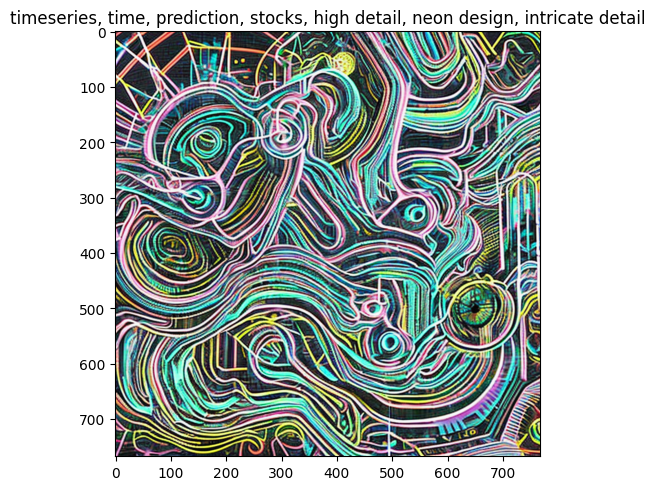

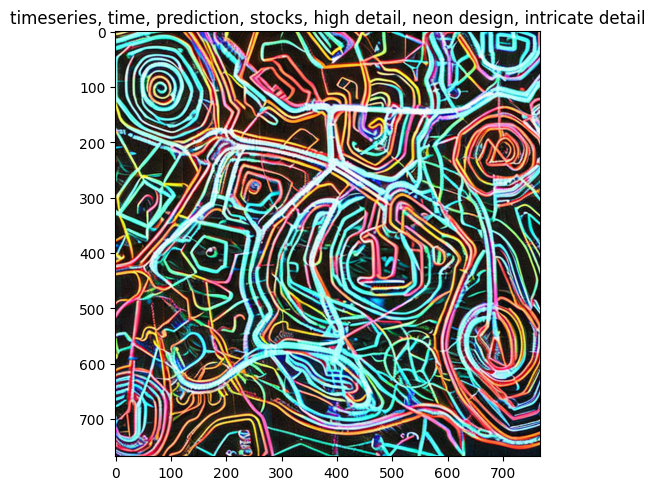

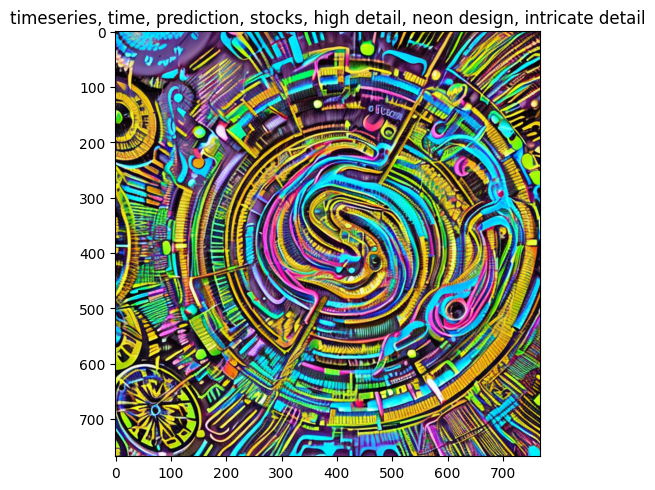

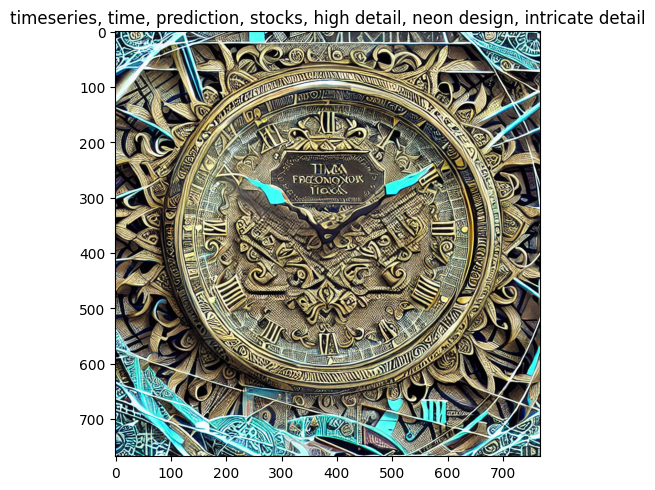

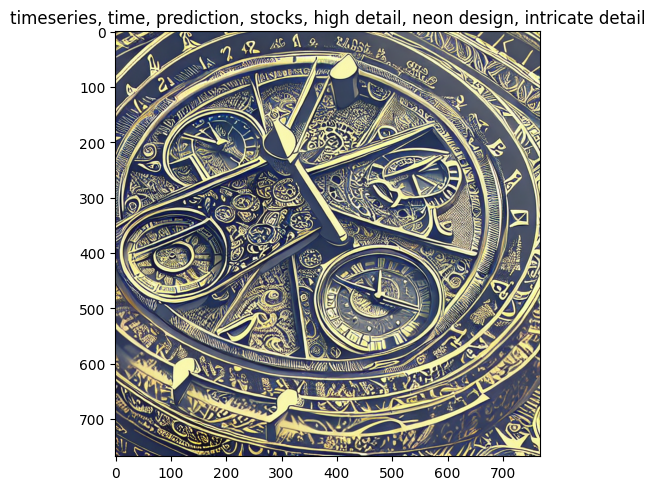

<Figure size 3200x3200 with 0 Axes>

In [ ]:
import tensorflow as tf
import numpy as np
from google.colab import files

counter = 1
for i in list_of_selected_images:
    image = combined_list_images[i - 1]
    prompt = combined_list_prompts[i - 1]
    model_id = combined_list_generated_models[i - 1]
    #tag_values = combined_list_generated_tags[i - 1]
    print(f"{i}_{prompt} - {model_id}") #- {tag_values}
    fig = plt.figure(figsize=(32, 32))
    columns = 4
    rows = 5
    # for j in range(1, len(list_of_selected_images)):
    fig.add_subplot(rows, columns, counter)
    plt.title(f"{combined_list_prompts[i - 1]}") #- {combined_list_generated_tags[i - 1]}
    plt.imshow(combined_list_images[i - 1])
    image.save(f'{i}.png')
    files.download(f'{i}.png')
    counter += counter
plt.show()

### increase image resolution

In [ ]:
for index, promptvalue in enumerate(ideas):
  prompt = promptvalue
  tag = tags[index]
  list_images = []
  list_generated_models = []
  num_images = 2
  for index, model_id in enumerate(model_ids):
    for number_images in range(num_images):
      combined_list_generated_models.append(model_id)
      combined_list_prompts.append(prompt)
      combined_list_generated_tags.append(tag)

print(combined_list_generated_models)
print(combined_list_prompts)
print(combined_list_generated_tags)

['stabilityai/stable-diffusion-2-1', 'stabilityai/stable-diffusion-2-1', 'dreamlike-art/dreamlike-photoreal-2.0', 'dreamlike-art/dreamlike-photoreal-2.0', 'dreamlike-art/dreamlike-anime-1.0', 'dreamlike-art/dreamlike-anime-1.0', 'hakurei/waifu-diffusion', 'hakurei/waifu-diffusion', 'ckpt/anything-v4.5', 'ckpt/anything-v4.5', 'Joeythemonster/anything-midjourney-v-4-1', 'Joeythemonster/anything-midjourney-v-4-1', 'prompthero/openjourney', 'prompthero/openjourney', 'andite/cutesexyrobutts-diffusion', 'andite/cutesexyrobutts-diffusion', 'stabilityai/stable-diffusion-2-1', 'stabilityai/stable-diffusion-2-1', 'dreamlike-art/dreamlike-photoreal-2.0', 'dreamlike-art/dreamlike-photoreal-2.0', 'dreamlike-art/dreamlike-anime-1.0', 'dreamlike-art/dreamlike-anime-1.0', 'hakurei/waifu-diffusion', 'hakurei/waifu-diffusion', 'ckpt/anything-v4.5', 'ckpt/anything-v4.5', 'Joeythemonster/anything-midjourney-v-4-1', 'Joeythemonster/anything-midjourney-v-4-1', 'prompthero/openjourney', 'prompthero/openjourn

In [ ]:
import os
import time
from PIL import Image
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt
os.environ["TFHUB_DOWNLOAD_PROGRESS"] = "True"

SAVED_MODEL_PATH = "https://tfhub.dev/captain-pool/esrgan-tf2/1"
model = hub.load(SAVED_MODEL_PATH)

def preprocess_image(image_path):
  """ Loads image from path and preprocesses to make it model ready
      Args:
        image_path: Path to the image file
  """
  hr_image = tf.image.decode_image(tf.io.read_file(image_path))
  # If PNG, remove the alpha channel. The model only supports
  # images with 3 color channels.
  if hr_image.shape[-1] == 4:
    hr_image = hr_image[...,:-1]
  hr_size = (tf.convert_to_tensor(hr_image.shape[:-1]) // 4) * 4
  hr_image = tf.image.crop_to_bounding_box(hr_image, 0, 0, hr_size[0], hr_size[1])
  hr_image = tf.cast(hr_image, tf.float32)
  return tf.expand_dims(hr_image, 0)

def generate_image(image):
  """
    Saves unscaled Tensor Images.
    Args:
      image: 3D image tensor. [height, width, channels]
      filename: Name of the file to save.
  """
  if not isinstance(image, Image.Image):
    image = tf.clip_by_value(image, 0, 255)
    image = Image.fromarray(tf.cast(image, tf.uint8).numpy())
    print("Generated Image .jpg")
  return image

%matplotlib inline
def plot_image(image, title=""):
  """
    Plots images from image tensors.
    Args:
      image: 3D image tensor. [height, width, channels].
      title: Title to display in the plot.
  """
  image = np.asarray(image)
  image = tf.clip_by_value(image, 0, 255)
  image = Image.fromarray(tf.cast(image, tf.uint8).numpy())
  plt.imshow(image)
  plt.axis("off")
  plt.title(title)

from google.colab import files

for i in list_of_selected_images:
  selected_image_path = f"{i}.png"
  selected_image = preprocess_image(selected_image_path)
  print(selected_image.shape)
  # plot_image(tf.squeeze(selected_image), title=f"Original Image - {i}.png")
  start = time.time()
  print(type(selected_image))
  selected_super_image = model(selected_image)
  selected_super_image = tf.squeeze(selected_super_image)
  print('Time taken to complete process: %f'%(time.time() - start))
  # plot_image(tf.squeeze(selected_super_image),f'Super Resolution - {i}.png')

  prompt = combined_list_prompts[i - 1]
  model_id = combined_list_generated_models[i - 1]
  tag_values = combined_list_generated_tags[i - 1]

  download_image = generate_image(selected_super_image)
  download_image.save(f"{i}_{prompt}_{tag_values}.jpg")
  files.download(f'{i}_{prompt}_{tag_values}.jpg')

(1, 512, 512, 3)
<class 'tensorflow.python.framework.ops.EagerTensor'>
Time taken to complete process: 16.949919
Generated Image .jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

(1, 512, 512, 3)
<class 'tensorflow.python.framework.ops.EagerTensor'>
Time taken to complete process: 0.174846
Generated Image .jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

(1, 512, 512, 3)
<class 'tensorflow.python.framework.ops.EagerTensor'>
Time taken to complete process: 0.171954
Generated Image .jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

(1, 512, 512, 3)
<class 'tensorflow.python.framework.ops.EagerTensor'>
Time taken to complete process: 0.175339
Generated Image .jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

(1, 512, 512, 3)
<class 'tensorflow.python.framework.ops.EagerTensor'>
Time taken to complete process: 0.227484
Generated Image .jpg


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import os
import time
from PIL import Image
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt
os.environ["TFHUB_DOWNLOAD_PROGRESS"] = "True"

In [ ]:
SAVED_MODEL_PATH = "https://tfhub.dev/captain-pool/esrgan-tf2/1"
model = hub.load(SAVED_MODEL_PATH)

In [ ]:
def preprocess_image(image):
  """ Loads image from path and preprocesses to make it model ready
      Args:
        image_path: Path to the image file
  """
  hr_image = tf.image.decode_image(image)
  # hr_image = tf.image.decode_image(tf.io.read_file(image_path))
  # If PNG, remove the alpha channel. The model only supports
  # images with 3 color channels.
  if hr_image.shape[-1] == 4:
    hr_image = hr_image[...,:-1]
  hr_size = (tf.convert_to_tensor(hr_image.shape[:-1]) // 4) * 4
  hr_image = tf.image.crop_to_bounding_box(hr_image, 0, 0, hr_size[0], hr_size[1])
  hr_image = tf.cast(hr_image, tf.float32)
  return tf.expand_dims(hr_image, 0)

def generate_image(image):
  """
    Saves unscaled Tensor Images.
    Args:
      image: 3D image tensor. [height, width, channels]
      filename: Name of the file to save.
  """
  if not isinstance(image, Image.Image):
    image = tf.clip_by_value(image, 0, 255)
    image = Image.fromarray(tf.cast(image, tf.uint8).numpy())
    print("Generated Image .jpg")
  return image

%matplotlib inline
def plot_image(image, title=""):
  """
    Plots images from image tensors.
    Args:
      image: 3D image tensor. [height, width, channels].
      title: Title to display in the plot.
  """
  image = np.asarray(image)
  image = tf.clip_by_value(image, 0, 255)
  image = Image.fromarray(tf.cast(image, tf.uint8).numpy())
  plt.imshow(image)
  plt.axis("off")
  plt.title(title)

In [ ]:
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following packages will be REMOVED:
  libcudnn8-dev
The following held packages will be changed:
  libcudnn8
The following packages will be DOWNGRADED:
  libcudnn8
0 upgraded, 0 newly installed, 1 downgraded, 1 to remove and 22 not upgraded.
Need to get 430 MB of archives.
After this operation, 1,153 MB disk space will be freed.
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  libcudnn8 8.1.0.77-1+cuda11.2 [430 MB]
Fetched 430 MB in 7s (64.3 MB/s)
(Reading database ... 122349 files and directories currently installed.)
Removing libcudnn8-dev (8.7.0.84-1+cuda11.8) ...
update-alternatives: removing manually selected alternative - switching libcudnn to auto mode
dpkg: warning: downgrading libcudnn8 from 8.7.0.84-1+cuda11.8 to 8.1.0.77-1+cuda11.2
(Reading database ... 122316 files and directories currently installed.)
Preparing to unpack .../libcudnn8_8.1.0.7

In [ ]:
NUMBER_OF_IMAGE = 15
combined_image = combined_list_images[NUMBER_OF_IMAGE]
print(type(combined_image))

img_to_tensor = tf.convert_to_tensor(combined_image)
print("dtype of tensor:",img_to_tensor.dtype)
if img_to_tensor.shape[-1] == 4:
  img_to_tensor = img_to_tensor[...,:-1]
hr_size = (tf.convert_to_tensor(img_to_tensor.shape[:-1]) // 4) * 4
img_to_tensor = tf.image.crop_to_bounding_box(img_to_tensor, 0, 0, hr_size[0], hr_size[1])
img_to_tensor = tf.cast(img_to_tensor, tf.float32)
img_to_tensor = tf.expand_dims(img_to_tensor, 0)
print(img_to_tensor.shape)
start = time.time()
print(type(img_to_tensor))
super_image = model(img_to_tensor)
super_image = tf.squeeze(super_image)
print('Time taken to complete process: %f'%(time.time() - start))

#preprocess_image(combined_image)
#image = Image.fromarray(tf.cast(hr_image, tf.uint8).numpy())
#X=np.asarray(X).astype(np.float32)
#hr_image = tf.cast(hr_image, tf.string)

# save a image using extension
#combined_image.save("geeks.jpg")
#im1 = Image.open(r"geeks.jpg")
# read_image = np.asarray(combined_image)
# img_to_tensor = tf.convert_to_tensor(read_image)
# img_to_string = tf.strings.as_string(img_to_tensor)
# print(type(img_to_string))
#read_image = tf.image.decode_image(im1)
#read_image = tf.image.decode_jpeg(img_to_tensor)
#img_resize = tf.image.resize_images(combined_image, [28,28])
#read_image = tf.image.decode_image(read_image)
#hr_image = tf.image.decode_image(tf.io.decode_jpeg(combined_image, channels=3))
# img_to_tensor = tf.convert_to_tensor(combined_image)
# print the converted Torch tensor
# print(img_to_tensor)
# print("dtype of tensor:",img_to_tensor.dtype)
#print(hr_image.size)
#plot_image(tf.squeeze(hr_image), title="Original Image")
#hr_image = tf.convert_to_tensor(tf.squeeze(hr_image))#, dtype=tf.uint8)
# hr_image = tf.image.decode_image(img_to_tensor, channels=3, dtype=tf.uint8)

# hr_image = tf.convert_to_tensor(hr_image)#, dtype=tf.uint8)
# if hr_image.shape[-1] == 4:
#   hr_image = hr_image[...,:-1]
# hr_size = (tf.convert_to_tensor(hr_image.shape[:-1]) // 4) * 4
# hr_image = tf.image.crop_to_bounding_box(hr_image, 0, 0, hr_size[0], hr_size[1])
# hr_image = tf.cast(hr_image, tf.float32)
# hr_image = tf.expand_dims(hr_image, 0)
#plot_image(tf.squeeze(hr_image), title="Original Image")

In [ ]:
start = time.time()
print(type(hr_image))
super_image = model(hr_image)
#super_image = tf.squeeze(super_image)
print('Time taken to complete process: %f'%(time.time() - start))

In [ ]:
original_image_resoltion = generate_image(hr_image)
h, w, c = original_image_resoltion.shape
print(f'width: {w}, height: {h}, channels: {c}')
plot_image(tf.squeeze(hr_image), title="Original Image")

In [ ]:
supe_image_resoltion = generate_image(super_image)
h, w, c = supe_image_resoltion.shape
print(f'width: {w}, height: {h}, channels: {c}')
plot_image(tf.squeeze(super_image),'Super Resolution Image')

In [ ]:
from google.colab import files

download_image = generate_image(super_image)
download_image.save(f"{combined_list_prompts[NUMBER_OF_IMAGE]}_{NUMBER_OF_IMAGE}.jpg")
files.download(f'{combined_list_prompts[NUMBER_OF_IMAGE]}_{NUMBER_OF_IMAGE}.jpg')

In [ ]:
import os
import time
from PIL import Image
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt
os.environ["TFHUB_DOWNLOAD_PROGRESS"] = "True"

In [ ]:
!wget "https://user-images.githubusercontent.com/12981474/40157448-eff91f06-5953-11e8-9a37-f6b5693fa03f.png" -O original.png

--2023-04-13 19:29:28--  https://user-images.githubusercontent.com/12981474/40157448-eff91f06-5953-11e8-9a37-f6b5693fa03f.png
Resolving user-images.githubusercontent.com (user-images.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to user-images.githubusercontent.com (user-images.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 34146 (33K) [image/png]
Saving to: ‘original.png’

original.png        100%[===================>]  33.35K  --.-KB/s    in 0.003s  

2023-04-13 19:29:28 (11.6 MB/s) - ‘original.png’ saved [34146/34146]



In [ ]:
#IMAGE_PATH = "original.png"
IMAGE_PATH = "dreamlike_anime_a pattern of different meadow flowers and daisy_super"
IMAGE_EXTENSION = "jpg"
image_full_path = IMAGE_PATH + '.' + IMAGE_EXTENSION
iamge_full_path_super_size = IMAGE_PATH + '_super'
SAVED_MODEL_PATH = "https://tfhub.dev/captain-pool/esrgan-tf2/1"
model = hub.load(SAVED_MODEL_PATH)

In [ ]:
def preprocess_image(image_path):
  """ Loads image from path and preprocesses to make it model ready
      Args:
        image_path: Path to the image file
  """
  hr_image = tf.image.decode_image(tf.io.read_file(image_path))
  # If PNG, remove the alpha channel. The model only supports
  # images with 3 color channels.
  if hr_image.shape[-1] == 4:
    hr_image = hr_image[...,:-1]
  hr_size = (tf.convert_to_tensor(hr_image.shape[:-1]) // 4) * 4
  hr_image = tf.image.crop_to_bounding_box(hr_image, 0, 0, hr_size[0], hr_size[1])
  hr_image = tf.cast(hr_image, tf.float32)
  return tf.expand_dims(hr_image, 0)

In [ ]:
def save_image(image, filename):
  """
    Saves unscaled Tensor Images.
    Args:
      image: 3D image tensor. [height, width, channels]
      filename: Name of the file to save.
  """
  if not isinstance(image, Image.Image):
    image = tf.clip_by_value(image, 0, 255)
    image = Image.fromarray(tf.cast(image, tf.uint8).numpy())
  image.save("%s.jpg" % filename)
  print("Saved as %s.jpg" % filename)

In [ ]:
%matplotlib inline
def plot_image(image, title=""):
  """
    Plots images from image tensors.
    Args:
      image: 3D image tensor. [height, width, channels].
      title: Title to display in the plot.
  """
  image = np.asarray(image)
  image = tf.clip_by_value(image, 0, 255)
  image = Image.fromarray(tf.cast(image, tf.uint8).numpy())
  plt.imshow(image)
  plt.axis("off")
  plt.title(title)

In [ ]:
hr_image = preprocess_image(image_full_path)
print(hr_image.shape)
print(hr_image)

(1, 2048, 2048, 3)
tf.Tensor(
[[[[ 44.  40.  15.]
   [ 66.  60.  34.]
   [ 86.  74.  48.]
   ...
   [ 36.  69.  48.]
   [ 16.  60.  47.]
   [ 21.  71.  62.]]

  [[ 61.  54.  25.]
   [ 79.  72.  43.]
   [ 97.  86.  56.]
   ...
   [ 37.  71.  46.]
   [ 21.  63.  43.]
   [ 24.  71.  53.]]

  [[ 84.  72.  32.]
   [ 94.  85.  46.]
   [104.  94.  59.]
   ...
   [ 26.  60.  27.]
   [ 16.  54.  17.]
   [ 16.  58.  20.]]

  ...

  [[ 84.  88.  65.]
   [ 58.  66.  42.]
   [ 37.  49.  25.]
   ...
   [ 41.  84.  41.]
   [ 40.  85.  42.]
   [ 36.  81.  38.]]

  [[ 77.  79.  55.]
   [ 51.  56.  33.]
   [ 44.  56.  32.]
   ...
   [ 36.  69.  50.]
   [ 26.  56.  32.]
   [ 19.  48.  20.]]

  [[ 74.  76.  52.]
   [ 50.  56.  30.]
   [ 56.  66.  42.]
   ...
   [ 29.  59.  51.]
   [ 37.  59.  46.]
   [ 47.  68.  49.]]]], shape=(1, 2048, 2048, 3), dtype=float32)


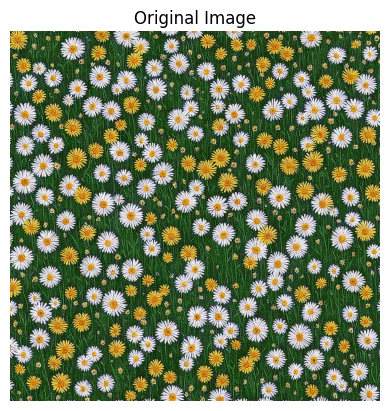

In [ ]:
# Plotting Original Resolution image
plot_image(tf.squeeze(hr_image), title="Original Image")

In [ ]:
start = time.time()
print(type(hr_image))
super_image = model(hr_image)
super_image = tf.squeeze(super_image)
print('Time taken to complete process: %f'%(time.time() - start))

In [ ]:
plot_image(tf.squeeze(super_image),'Super Resolution')